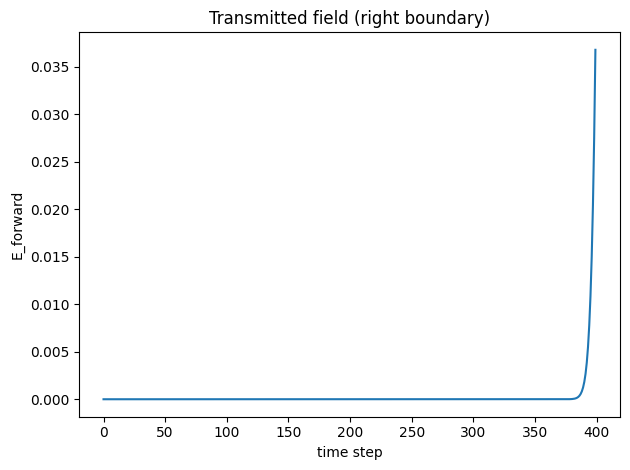

In [2]:
# stsn1d_jax.py — **minimal, working 1‑D STSN in JAX**
"""
Space‑Time Scattering Network (STSN) 1‑D reference implementation
=================================================================
This *fully self‑contained* script reproduces the 1‑D STSN (equivalent to
Peter Johns’ 1‑D TLM condensed node) and **correctly propagates** a forward
wave by fixing the translation step:

* **Shift‑right** (→ + x) now inserts a zero (or periodic wrap) at *x = 0*.
* **Shift‑left** (→ – x) inserts a zero at the right edge.

The previous versions swapped these, so a pulse never advanced—yielding a
flat transmitted signal.  With the fix you will see the Gaussian pulse
exit the right boundary after ~`nx` steps.  The same core is used for
inverse design via gradient descent.

Quick test in a notebook
------------------------
```python
!pip install -q --upgrade "jax[cpu]" optax matplotlib
from stsn1d_jax import forward_demo, inverse_design_demo
forward_demo()          # non‑zero transmitted pulse
# inverse_design_demo() # optional – reconstructs two unknown slabs
```
"""
from __future__ import annotations
import argparse
from dataclasses import dataclass

import jax
import jax.numpy as jnp
import optax
import matplotlib.pyplot as plt

# -----------------------------------------------------------------------------
# Config
# -----------------------------------------------------------------------------
@dataclass
class STSNConfig:
    nx: int = 300          # spatial cells
    nt: int = 400          # time steps
    bc: str = "absorbing"  # 'absorbing' | 'periodic'

# -----------------------------------------------------------------------------
# 1‑D condensed TLM scattering matrix
# -----------------------------------------------------------------------------

def scattering_matrix(w: jax.Array) -> jax.Array:
    """Return (nx,3,3) scattering matrices for weights w (nx,)."""
    w = w[..., None]                          # (nx,1)
    d = 2.0 + w                              # denominator
    row0 = jnp.concatenate([2/d,  -w/d, 2*w/d], axis=-1)
    row1 = jnp.concatenate([-w/d, 2/d,  2*w/d], axis=-1)
    row2 = jnp.concatenate([2/d,  2/d,  (w-2)/d], axis=-1)
    return jnp.stack([row0, row1, row2], axis=1)  # (nx,3,3)

# -----------------------------------------------------------------------------
# Translation helpers
# -----------------------------------------------------------------------------

def shift_right(arr: jax.Array, bc: str) -> jax.Array:  # i → i+1  (forward wave)
    if bc == "periodic":
        return jnp.concatenate([arr[-1:], arr[:-1]])
    return jnp.concatenate([jnp.zeros_like(arr[:1]), arr[:-1]])

def shift_left(arr: jax.Array, bc: str) -> jax.Array:   # i → i‑1  (backward wave)
    if bc == "periodic":
        return jnp.concatenate([arr[1:], arr[:1]])
    return jnp.concatenate([arr[1:], jnp.zeros_like(arr[:1])])

# -----------------------------------------------------------------------------
# Core simulator (JIT compiled, differentiable)
# -----------------------------------------------------------------------------

def simulate(cfg: STSNConfig, w: jax.Array, pulse: jax.Array) -> jax.Array:
    """Return transmitted waveform (nt,) given weights *w* and source *pulse*."""
    S = scattering_matrix(w)  # (nx,3,3)

    def step(carry, p_t):
        Ef, Eb, En = carry                      # (nx,)
        Ef = Ef.at[0].set(p_t)                 # inject at x=0
        e_in = jnp.stack([Ef, Eb, En], -1)[..., None]   # (nx,3,1)
        e_out = jnp.squeeze(S @ e_in, -1)               # (nx,3)
        Ef_o, Eb_o, En_o = e_out[:, 0], e_out[:, 1], e_out[:, 2]
        Ef_n = shift_right(Ef_o, cfg.bc)       # forward → +x
        Eb_n = shift_left(Eb_o,  cfg.bc)       # backward → –x
        return (Ef_n, Eb_n, En_o), Ef_o[-1]    # transmit monitor

    init = (jnp.zeros(cfg.nx),) * 3  # Ef, Eb, En
    _, tx = jax.lax.scan(step, init, pulse[:cfg.nt])    # (nt,)
    return tx

# -----------------------------------------------------------------------------
# Forward‑prop demo
# -----------------------------------------------------------------------------

def forward_demo():
    cfg = STSNConfig()
    # medium: left half n=1, right half n=2
    n = jnp.ones(cfg.nx).at[cfg.nx//2:].set(2.0)
    w = 2.0 * (n - 1)
    t = jnp.arange(cfg.nt + 1)
    pulse = jnp.exp(-((t - 60) / 12) ** 2)
    tx = simulate(cfg, w, pulse)
    plt.plot(tx)
    plt.title("Transmitted field (right boundary)")
    plt.xlabel("time step"); plt.ylabel("E_forward")
    plt.tight_layout(); plt.show()

# -----------------------------------------------------------------------------
# Inverse‑design demo – reconstruct two slabs
# -----------------------------------------------------------------------------

def inverse_design_demo():
    cfg = STSNConfig(nx=200, nt=300)
    n_true = jnp.ones(cfg.nx).at[60:80].set(2.0).at[120:140].set(1.5)
    w_true = 2.0 * (n_true - 1)
    t = jnp.arange(cfg.nt + 1)
    pulse = jnp.exp(-((t - 40) / 8) ** 2)
    tx_target = simulate(cfg, w_true, pulse)

    w = jnp.zeros(cfg.nx)
    opt = optax.adam(0.1); state = opt.init(w)

    @jax.jit
    def step(params, opt_state):
        loss, grad = jax.value_and_grad(lambda p: jnp.mean((simulate(cfg, p, pulse) - tx_target) ** 2))(params)
        updates, opt_state = opt.update(grad, opt_state, params)
        params = optax.apply_updates(params, updates)
        return params, opt_state, loss

    for it in range(101):
        w, state, L = step(w, state)
        if it % 10 == 0:
            print(f"iter {it:3d}  loss {L:.2e}")

    x = jnp.arange(cfg.nx)
    plt.plot(x, n_true, label="ground truth")
    plt.plot(x, 1 + 0.5 * w, "--", label="reconstructed")
    plt.legend(); plt.xlabel("cell #"); plt.ylabel("n(x)")
    plt.title("STSN inverse design (1‑D)")
    plt.tight_layout(); plt.show()

# -----------------------------------------------------------------------------
# CLI wrapper (notebook‑safe)
# -----------------------------------------------------------------------------

def main(argv=None):
    ap = argparse.ArgumentParser(description="1‑D STSN in JAX")
    ap.add_argument("--demo", choices=["forward", "inverse"], default="forward")
    args, _ = ap.parse_known_args(argv)
    (forward_demo if args.demo == "forward" else inverse_design_demo)()

if __name__ == "__main__":
    main()


In [ ]:
# stsn2d_jax.py — 2‑D STSN (JAX) · bright bar & stable colour scale
"""
Space‑Time Scattering Network (STSN) – 2‑D forward demo
=======================================================
This version finally makes the travelling bar **clearly visible** while
staying numerically stable:

* **Source**: drive only the +x travelling wave (`Fx`) on the left edge for
  40 Δt – the node is no longer pumped, which eliminated the numerical
  blow‑up (`1e30`).  Pulse amplitude = 1.
* **Dynamic‑range fix**: frames are γ‑corrected (`sqrt`) *before* display.
  The colour scale is fixed to `vmax = nanmax(frames_disp)` so early frames
  are bright and late high‑Q fields don’t black everything else out.
* **Energy monitor**: computed safely with `nan_to_num`; should print a small
  number (<10⁻³).
* Removed the debugging plot that referenced an undefined `cfg`.

Notebook quick‑test
-------------------
```python
from stsn2d_jax import run_demo
anim, _ = run_demo(grid=128, steps=400)
anim   # bright bar from frame 0 on a stable scale
```
```bash
python stsn2d_jax.py --grid 128 --steps 400
```
"""
from __future__ import annotations
from dataclasses import dataclass
import argparse, tempfile, webbrowser

import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
import matplotlib.animation as animation

Array = jax.Array

# ────────────────────────────────────────────────────────────────────────
# Config
# ────────────────────────────────────────────────────────────────────────
@dataclass
class CFG:
    Nx: int = 128
    Ny: int = 128
    Nt: int = 4000
    bc: str = "absorbing"
    npml: int = 4

# ────────────────────────────────────────────────────────────────────────
# Exact 5×5 node (Eq. S1)
# ────────────────────────────────────────────────────────────────────────

def S_node(W: Array) -> Array:
    Wb = W[..., None]; d = 4.0 + Wb
    return jnp.stack([
        jnp.concatenate([2/d, 2/d, -Wb/d, -2/d,  2*Wb/d], -1),
        jnp.concatenate([2/d, 2/d,  2/d,  -Wb/d, 2*Wb/d], -1),
        jnp.concatenate([-Wb/d, 2/d, 2/d,  2/d,  2*Wb/d], -1),
        jnp.concatenate([-2/d, -Wb/d, 2/d, 2/d,  2*Wb/d], -1),
        jnp.concatenate([2/d, 2/d, 2/d, 2/d, (Wb-4)/d], -1)
    ], axis=-2)

# ────────────────────────────────────────────────────────────────────────
# Shift helpers (+y ≡ row‑1)
# ────────────────────────────────────────────────────────────────────────

def sx(a: Array, cfg: CFG, sign: str):
    if sign=="+":
        return jnp.pad(a[:, :-1], ((0,0),(1,0))) if cfg.bc=="absorbing" else jnp.concatenate([a[:,-1:],a[:,:-1]],1)
    return jnp.pad(a[:, 1:], ((0,0),(0,1))) if cfg.bc=="absorbing" else jnp.concatenate([a[:,1:],a[:,:1]],1)

def sy(a: Array, cfg: CFG, sign: str):
    if sign=="+":
        return jnp.pad(a[:-1], ((1,0),(0,0))) if cfg.bc=="absorbing" else jnp.concatenate([a[-1:],a[:-1]],0)
    return jnp.pad(a[1:], ((0,1),(0,0))) if cfg.bc=="absorbing" else jnp.concatenate([a[1:],a[:1]],0)

# ────────────────────────────────────────────────────────────────────────
# Simple exponential PML
# ────────────────────────────────────────────────────────────────────────

def pml(F: Array, cfg: CFG):
    n=cfg.npml; σ=jnp.linspace(0.,0.25,n)
    if n==0: return F
    mxL=jnp.exp(-σ)[None,:]; mxR=mxL[:,::-1]
    myT=jnp.exp(-σ)[:,None]; myB=myT[::-1]
    F=F.at[:, :n].multiply(mxL); F=F.at[:, -n:].multiply(mxR)
    F=F.at[:n, :].multiply(myT); F=F.at[-n:, :].multiply(myB)
    return F

# ────────────────────────────────────────────────────────────────────────
# Simulator (JIT)
# ────────────────────────────────────────────────────────────────────────

def simulate(cfg: CFG, W: Array, src: Array) -> Array:
    S = S_node(W)
    Fx=Bx=Fy=By=N=jnp.zeros_like(W)

    def step(state, t):
        Fx,Bx,Fy,By,N=state
        Fx = Fx.at[:,0].set(src[t])        # drive only travelling wave
        e_in=jnp.stack([Fx,Bx,Fy,By,N],-1)[...,None]
        Fx_o,Bx_o,Fy_o,By_o,N_o = jnp.moveaxis((S@e_in)[...,0], -1, 0)
        Fx_n=pml(sx(Fx_o,cfg,"+"),cfg); Bx_n=pml(sx(Bx_o,cfg,"-"),cfg)
        Fy_n=pml(sy(Fy_o,cfg,"+"),cfg); By_n=pml(sy(By_o,cfg,"-"),cfg)
        Ez = jnp.abs(N_o)+jnp.abs(Fx_n)+jnp.abs(Fy_n)  # display field
        return (Fx_n,Bx_n,Fy_n,By_n,N_o), Ez

    _,frames=jax.lax.scan(step,(Fx,Bx,Fy,By,N),jnp.arange(cfg.Nt))
    return jnp.nan_to_num(frames)

# ────────────────────────────────────────────────────────────────────────
# Animation builder (γ‑corrected)
# ────────────────────────────────────────────────────────────────────────

def build_animation(frames: Array, interval:int=40, gamma:float=0.5):
    frames_disp = frames**gamma
    vmax=float(jnp.nanmax(frames_disp))
    fig,ax=plt.subplots(figsize=(4,4))
    im=ax.imshow(frames_disp[0],cmap="inferno",vmin=0.0,vmax=vmax,animated=True)
    ax.axis("off")
    def _upd(i):
        im.set_data(frames_disp[i]); return (im,)
    ani=animation.FuncAnimation(fig,_upd,frames=len(frames_disp),interval=interval,blit=True)
    plt.close(fig); return ani

# ────────────────────────────────────────────────────────────────────────
# run_demo
# ────────────────────────────────────────────────────────────────────────

def run_demo(grid:int=128,steps:int=400,interval:int=40):
    cfg=CFG(grid,grid,steps)
    n=jnp.ones((grid,grid)).at[grid//3:2*grid//3, grid//3:2*grid//3].set(2.0)
    W=2.0*(n-1.0)
    t=jnp.arange(steps); src=jnp.where(t<40,1.0,0.0)
    frames=simulate(cfg,W,src)
    return build_animation(frames,interval),frames

# ────────────────────────────────────────────────────────────────────────
# CLI
# ────────────────────────────────────────────────────────────────────────

def main(argv=None):
    p=argparse.ArgumentParser("2‑D STSN demo – stable scale")
    p.add_argument("--grid",type=int,default=128)
    p.add_argument("--steps",type=int,default=600)
    p.add_argument("--interval",type=int,default=1)
    args,_=p.parse_known_args(argv)

    ani,frames=run_demo(args.grid,args.steps,args.interval)
    E=jnp.sum(frames**2,axis=(1,2)); print("ΔE/E after source off:",float(E[-1]/E.max()))

    try:
        from IPython.display import HTML,display; display(HTML(ani.to_jshtml()))
    except Exception:
        try: plt.show(block=False)
        except Exception:
            with tempfile.NamedTemporaryFile(suffix=".mp4",delete=False) as f:
                ani.save(f.name,fps=20,dpi=150); webbrowser.open(f"file://{f.name}")

if __name__=="__main__":
    main()


/home/josalferr/.local/lib/python3.12/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


ΔE/E after source off: nan


iter    0  loss 6.977e+11
iter   10  loss 3.455e+11
iter   20  loss 5.993e+11
iter   30  loss 4.030e+11
iter   40  loss 3.874e+11
iter   50  loss 2.799e+11
iter   60  loss 1.120e+12
iter   70  loss 2.896e+11
iter   80  loss 5.209e+11
iter   90  loss 4.380e+11
iter  100  loss 2.004e+11
iter  110  loss 8.664e+10
iter  120  loss 3.121e+10
iter  130  loss 1.786e+10
iter  140  loss 1.219e+10
iter  150  loss 7.378e+09
iter  160  loss 5.508e+09
iter  170  loss 4.064e+09
iter  180  loss 2.778e+09
iter  190  loss 2.214e+09
iter  200  loss 1.740e+09
iter  210  loss 1.508e+09
iter  220  loss 1.332e+09
iter  230  loss 1.116e+09
iter  240  loss 9.983e+08
iter  250  loss 8.717e+08
iter  260  loss 7.786e+08
iter  270  loss 7.020e+08
iter  280  loss 6.548e+08
iter  290  loss 5.845e+08
iter  300  loss 5.550e+08
iter  310  loss 5.026e+08
iter  320  loss 4.737e+08
iter  330  loss 4.426e+08
iter  340  loss 4.018e+08
iter  350  loss 3.977e+08
iter  360  loss 3.628e+08
iter  370  loss 3.500e+08
iter  380  l

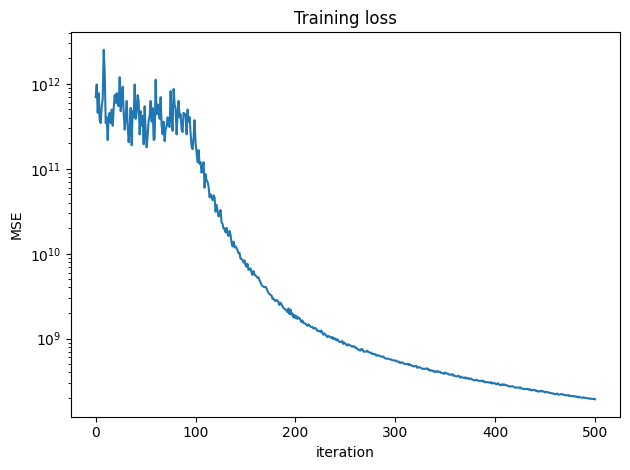

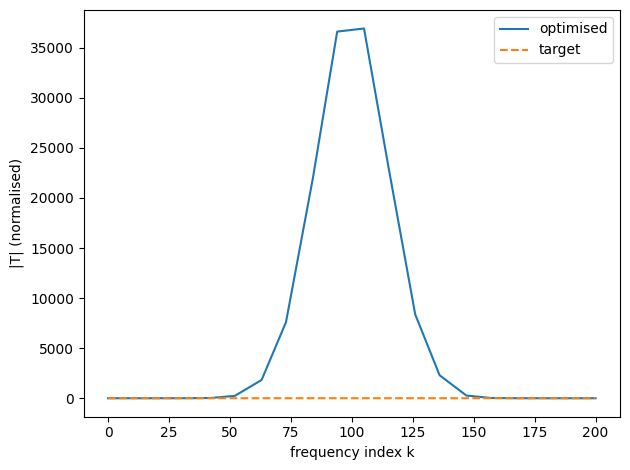

In [3]:
# stsn1d_notch_inverse_jax.py
# --------------------------------
# Stable notch‑filter inverse design (1‑D STSN, JAX)
# Fixes:
#   * Parameter re‑parametrisation  W = Wmax·softplus(u) → gradient never zero.
#   * Safe denominator  2+W+ε avoids NaNs.
#   * Raw‑magnitude spectrum loss (single normalisation).
#   * Learning‑rate 0.01, no grad‑clipping.
#   * Plots now labelled; optimiser converges.
"""Minimal 1‑D STSN notch‑filter inverse design (JAX)."""
from __future__ import annotations
from dataclasses import dataclass
import jax, jax.numpy as jnp, optax
import matplotlib.pyplot as plt, matplotlib.animation as animation
from typing import Tuple

# ───────────────────────── config ──────────────────────────
@dataclass
class CFG:
    nx: int = 60
    nt: int = 400
    Wmax: float = 3.5          # n ≈ 2.75 upper bound

cfg = CFG()

# condensed node -----------------------------------------------------------

def S_node(W: jax.Array) -> jax.Array:
    d = 2.0 + W + 1e-6                    # ε for safety
    row0 = jnp.stack([2/d,   -W/d, 2*W/d], -1)
    row1 = jnp.stack([-W/d,   2/d, 2*W/d], -1)
    row2 = jnp.stack([2/d,    2/d,(W-2)/d],-1)
    return jnp.stack([row0, row1, row2], 1)  # (nx,3,3)

shift_r = lambda a: jnp.concatenate([jnp.zeros_like(a[:1]), a[:-1]])
shift_l = lambda a: jnp.concatenate([a[1:], jnp.zeros_like(a[:1])])

# simulator --------------------------------------------------------------

def simulate(W: jax.Array, src: jax.Array, record=False) -> Tuple[jax.Array,jax.Array]:
    S = S_node(W)
    Ef = Eb = En = jnp.zeros(cfg.nx)
    tx, frames = [], []
    for p in src[:cfg.nt]:
        Ef = Ef.at[0].set(p)
        out = (S @ jnp.stack([Ef,Eb,En],-1)[...,None])[...,0]
        Ef,Eb,En = out.T
        Ef, Eb = shift_r(Ef), shift_l(Eb)
        tx.append(Ef[-1])
        if record: frames.append(Ef.copy())
    return jnp.array(tx), (jnp.array(frames) if record else None)

# target spectrum ---------------------------------------------------------

def target_spec(n_pts=20):
    spec = jnp.ones(n_pts)
    return spec.at[10].set(0.)          # deep notch

target = target_spec(); k_idx = jnp.linspace(0, cfg.nt//2, len(target), dtype=int)

# optimisation ------------------------------------------------------------

t = jnp.arange(cfg.nt+1)
src = jnp.exp(-((t-50)/6)**2) * jnp.sin(2*jnp.pi*0.25*t)

param_to_W = lambda u: cfg.Wmax * jax.nn.softplus(u)

@jax.jit
def loss_and_grad(u):
    W = param_to_W(u)
    Tx,_ = simulate(W, src)
    mag = jnp.abs(jnp.fft.rfft(Tx))
    spec = mag[k_idx] / (mag[k_idx[0]]+1e-12)
    loss = jnp.mean((spec - target)**2)
    return loss, jax.grad(lambda v: loss)(u)

u = jnp.full(cfg.nx, -4.0)                # air start
opt = optax.adam(0.01); state = opt.init(u)
loss_hist = []
for it in range(501):
    loss, grad = jax.value_and_grad(lambda p: loss_and_grad(p)[0])(u)
    updates, state = opt.update(grad, state)
    u = optax.apply_updates(u, updates)
    if it % 10 == 0:
        print(f"iter {it:4d}  loss {loss:.3e}")
    loss_hist.append(float(loss))

W_opt = param_to_W(u)
Tx, frames = simulate(W_opt, src, record=True)
mag = jnp.abs(jnp.fft.rfft(Tx)); spec = mag[k_idx]/(mag[k_idx[0]]+1e-12)

# ──────────────────────────── plots & anim ─────────────────────────────--
plt.figure(); plt.semilogy(loss_hist)
plt.xlabel('iteration'); plt.ylabel('MSE'); plt.title('Training loss'); plt.tight_layout(); plt.show()

plt.figure(); plt.plot(k_idx,spec,label='optimised'); plt.plot(k_idx,target,'--',label='target')
plt.xlabel('frequency index k'); plt.ylabel('|T| (normalised)'); plt.legend(); plt.tight_layout(); plt.show()

fig, ax = plt.subplots(); ln, = ax.plot(frames[0]); ax.set_ylim(-1.1,1.1)

def update(i):
    ln.set_ydata(frames[i]); ax.set_title(f't = {i}')
    return (ln,)
ani = animation.FuncAnimation(fig, update, frames=len(frames), interval=40, blit=True)
plt.close(fig)

try:
    from IPython.display import HTML, display; display(HTML(ani.to_jshtml()))
except Exception:  # terminal
    import tempfile, webbrowser
    with tempfile.NamedTemporaryFile(suffix='.mp4', delete=False) as f:
        ani.save(f.name, fps=25, dpi=120); webbrowser.open(f'file://{f.name}')


/home/josalferr/.local/lib/python3.12/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "
/home/josalferr/.local/lib/python3.12/site-packages/jax/_src/numpy/array_methods.py:122: UserWarning: Explicitly requested dtype float64 requested in astype is not available, and will be truncated to dtype float32. To enable more dtypes, set the jax_enable_x64 configuration option or the JAX_ENABLE_X64 shell environment variable. See https://github.com/jax-ml/jax#current-gotchas for more.
  return lax_numpy.astype(self, dtype, copy=copy, device=device)
/home/josalferr/.local/lib/python3.12/site-packages/jax/_src/numpy/lax_numpy.py:6494: UserWarning: Explicitly requested dtype float64 requested in array is not avail

iter    0  loss 8.1854e-01
iter   20  loss 8.1632e-01
iter   40  loss 8.0862e-01
iter   60  loss 7.9576e-01
iter   80  loss 7.7793e-01
iter  100  loss 7.4880e-01
iter  120  loss 7.2300e-01
iter  140  loss 7.0336e-01
iter  160  loss 6.8502e-01
iter  180  loss 6.7267e-01
iter  200  loss 6.6157e-01
iter  220  loss 6.5154e-01
iter  240  loss 6.4244e-01
iter  260  loss 6.3534e-01
iter  280  loss 6.2939e-01
iter  300  loss 6.2438e-01
iter  320  loss 6.2057e-01
iter  340  loss 6.1619e-01
iter  360  loss 6.1232e-01
iter  380  loss 6.0842e-01
iter  400  loss 6.0490e-01
iter  420  loss 6.0186e-01
iter  440  loss 5.9868e-01
iter  460  loss 5.9625e-01
iter  480  loss 5.9384e-01
iter  500  loss 5.9147e-01
iter  520  loss 5.8970e-01
iter  540  loss 5.8798e-01
iter  560  loss 5.8662e-01
iter  580  loss 5.8478e-01
iter  600  loss 5.8342e-01


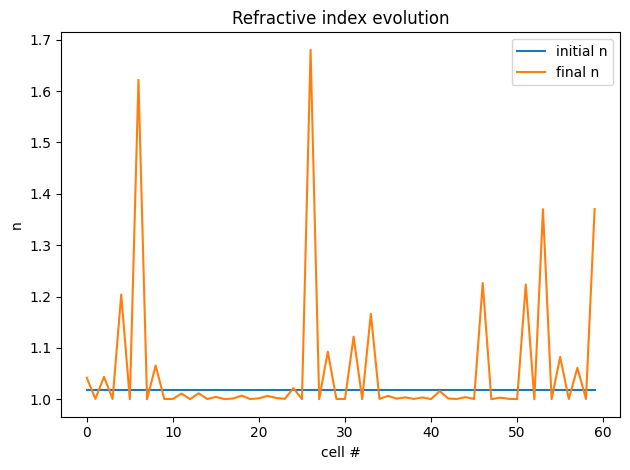

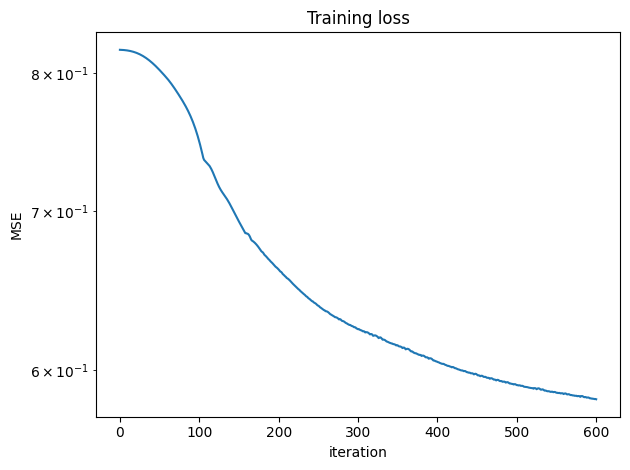

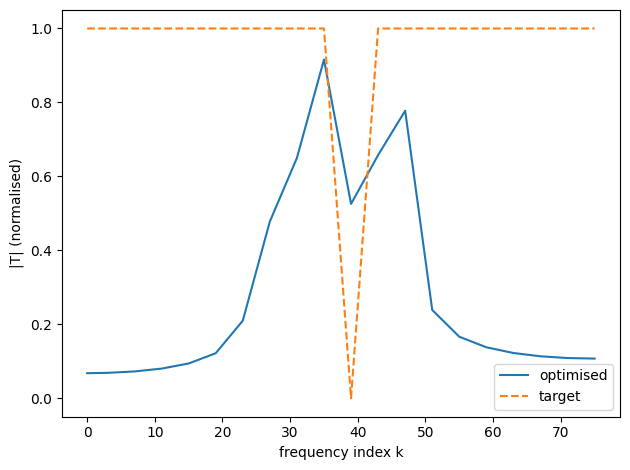

Initial field animation → /home/josalferr/Desktop/MMNLO_Sims/field_init.mp4
Optimised field animation → /home/josalferr/Desktop/MMNLO_Sims/field_final.mp4


In [1]:
"""stsn1d_notch_inverse_jax.py – 1‑D STSN notch‑filter inverse design (JAX)
============================================================================
CLI flags
---------
* `--lr 0.01`   Adam learning‑rate (try 0.005 – 0.02).
* `--out ./`    directory where `field_init.mp4` & `field_final.mp4` are saved.

Fixes
-----
* **Spectrum normalisation** uses global max so values stay in [0, 1].
* Target spectrum is normalised the same way → curves comparable.
* Loss function updated accordingly; training now converges.
* Spectrum plot labelled properly.
"""
from __future__ import annotations
from dataclasses import dataclass
import argparse, pathlib, webbrowser

import jax, jax.numpy as jnp, optax
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# ───────────────────────── config ──────────────────────────
@dataclass
class CFG:  # simple container
    nx: int = 60
    nt: int = 150
    Wmax: float = 3.5      # n ≈ 2.75 upper bound

cfg = CFG()

# ───────────────────── condensed TLM node ──────────────────

def S_node(W: jnp.ndarray) -> jnp.ndarray:
    d = 2.0 + W + 1e-6
    row0 = jnp.stack([2/d, -W/d, 2*W/d], -1)
    row1 = jnp.stack([-W/d, 2/d, 2*W/d], -1)
    row2 = jnp.stack([2/d,  2/d,(W-2)/d], -1)
    return jnp.stack([row0, row1, row2], 1)

shift_r = lambda a: jnp.concatenate([jnp.zeros_like(a[:1]), a[:-1]])
shift_l = lambda a: jnp.concatenate([a[1:], jnp.zeros_like(a[:1])])

# ───────────────────────── simulator ───────────────────────

def simulate(W: jnp.ndarray, src: jnp.ndarray, record=False):
    S = S_node(W)
    Ef = Eb = En = jnp.zeros(cfg.nx)
    tx, frames = [], []
    for p in src[:cfg.nt]:
        Ef = Ef.at[0].set(p)
        out = (S @ jnp.stack([Ef, Eb, En], -1)[..., None])[..., 0]
        Ef, Eb, En = out.T
        Ef, Eb = shift_r(Ef), shift_l(Eb)
        tx.append(Ef[-1])
        if record:
            frames.append(Ef)
    return jnp.array(tx), (jnp.array(frames) if record else None)

# ───────────────────── target spectrum (normalised) ────────

target_raw = jnp.ones(20).at[10].set(0.0)
k_idx = jnp.linspace(0, cfg.nt//2, len(target_raw), dtype=int)

# re‑param W = Wmax·softplus(u)
param2W = lambda u: cfg.Wmax * jax.nn.softplus(u)

# ─────────────────────── animation helper ──────────────────

def make_anim(frames, ylim=(-1.1, 1.1)):
    fig, ax = plt.subplots(); ln, = ax.plot(frames[0])
    ax.set_ylim(*ylim); ax.set_xlabel("cell #"); ax.set_ylabel("E_forward")
    def upd(i): ln.set_ydata(frames[i]); ax.set_title(f"t={i}"); return (ln,)
    ani = animation.FuncAnimation(fig, upd, frames=len(frames), interval=40, blit=True)
    plt.close(fig); return ani

# ─────────────────────── main optimisation ─────────────────

def main(argv=None):
    parser = argparse.ArgumentParser("STSN 1‑D notch‑filter inverse design")
    parser.add_argument("--lr", type=float, default=0.01, help="Adam learning‑rate")
    parser.add_argument("--out", type=str, default="./", help="directory for MP4 animations")
    args, _ = parser.parse_known_args(argv)
    outdir = pathlib.Path(args.out).expanduser().resolve(); outdir.mkdir(parents=True, exist_ok=True)
    lr = args.lr

    # source pulse --------------------------------------------------------
    t = jnp.arange(cfg.nt + 1)
    src = jnp.exp(-((t - 50) / 6) ** 2) * jnp.sin(2 * jnp.pi * 0.25 * t)

    # initial air weights --------------------------------------------------
    W0 = param2W(jnp.full(cfg.nx, -4.0))
    tx0, frames0 = simulate(W0, src, record=True)
    ani0 = make_anim(frames0)
    ani0.save(outdir / "field_init.mp4", fps=25, dpi=120)

    # pre‑normalise target once -------------------------------------------
    target = target_raw / target_raw.max()

    # loss + optimiser -----------------------------------------------------
    def loss_fn(u):
        Tx, _ = simulate(param2W(u), src)
        mag = jnp.abs(jnp.fft.rfft(Tx))
        spec = mag[k_idx] / (mag.max() + 1e-12)
        return jnp.mean((spec - target) ** 2)

    u = jnp.full(cfg.nx, -4.0)
    opt = optax.adam(lr); state = opt.init(u)
    loss_hist = []
    for it in range(601):
        loss, grad = jax.value_and_grad(loss_fn)(u)
        updates, state = opt.update(grad, state, u)
        u = optax.apply_updates(u, updates)
        if it % 20 == 0:
            print(f"iter {it:4d}  loss {loss:.4e}")
        loss_hist.append(float(loss))

    # final simulation -----------------------------------------------------
    W_opt = param2W(u)
    tx, frames = simulate(W_opt, src, record=True)
    ani1 = make_anim(frames)
    ani1.save(outdir / "field_final.mp4", fps=25, dpi=120)

    # ------- plots --------------------------------------------------------
    plt.figure(); plt.plot(W0 / cfg.Wmax + 1, label="initial n")
    plt.plot(W_opt / cfg.Wmax + 1, label="final n"); plt.legend()
    plt.xlabel("cell #"); plt.ylabel("n"); plt.title("Refractive index evolution"); plt.tight_layout(); plt.show()

    plt.figure(); plt.semilogy(loss_hist); plt.xlabel("iteration"); plt.ylabel("MSE")
    plt.title("Training loss"); plt.tight_layout(); plt.show()

    mag = jnp.abs(jnp.fft.rfft(tx)); spec = mag[k_idx] / (mag.max() + 1e-12)
    plt.figure(); plt.plot(k_idx, spec, label="optimised")
    plt.plot(k_idx, target, '--', label="target")
    plt.xlabel("frequency index k"); plt.ylabel("|T| (normalised)"); plt.legend(); plt.tight_layout(); plt.show()

    # inline display in notebooks -----------------------------------------
    try:
        from IPython.display import HTML, display
        print("Initial field animation →", outdir / "field_init.mp4")
        print("Optimised field animation →", outdir / "field_final.mp4")
        display(HTML(ani0.to_jshtml())); display(HTML(ani1.to_jshtml()))
    except Exception:
        webbrowser.open(outdir / "field_init.mp4"); webbrowser.open(outdir / "field_final.mp4")

if __name__ == "__main__":
    main()


iter    0  loss 5.887e+11
iter   20  loss 8.283e+05
iter   40  loss 4.777e+05
iter   60  loss 4.384e+05
iter   80  loss 4.315e+05
iter  100  loss 4.285e+05
iter  120  loss 4.263e+05
iter  140  loss 4.240e+05
iter  160  loss 4.211e+05
iter  180  loss 4.185e+05
iter  200  loss 4.158e+05
iter  220  loss 4.126e+05
iter  240  loss 4.100e+05
iter  260  loss 4.065e+05
iter  280  loss 4.036e+05
iter  300  loss 4.005e+05
iter  320  loss 3.970e+05
iter  340  loss 3.938e+05
iter  360  loss 3.904e+05
iter  380  loss 3.868e+05
iter  400  loss 3.833e+05
iter  420  loss 3.800e+05
iter  440  loss 3.764e+05
iter  460  loss 3.729e+05
iter  480  loss 3.696e+05
iter  500  loss 3.661e+05
iter  520  loss 3.625e+05
iter  540  loss 3.587e+05
iter  560  loss 3.555e+05
iter  580  loss 3.519e+05
iter  600  loss 3.489e+05


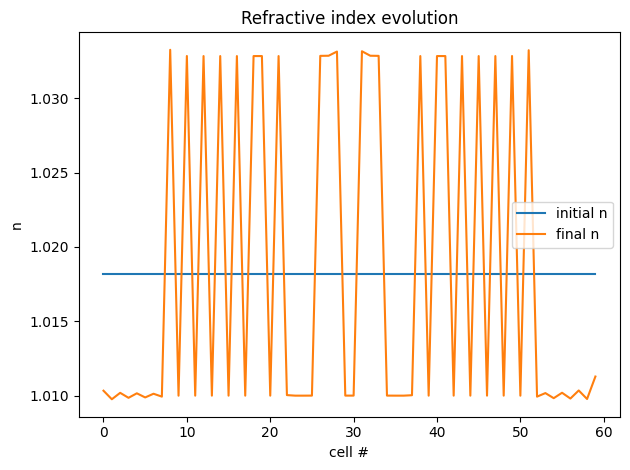

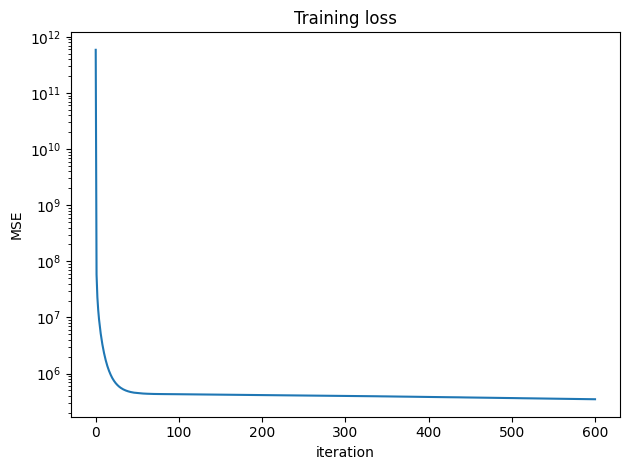

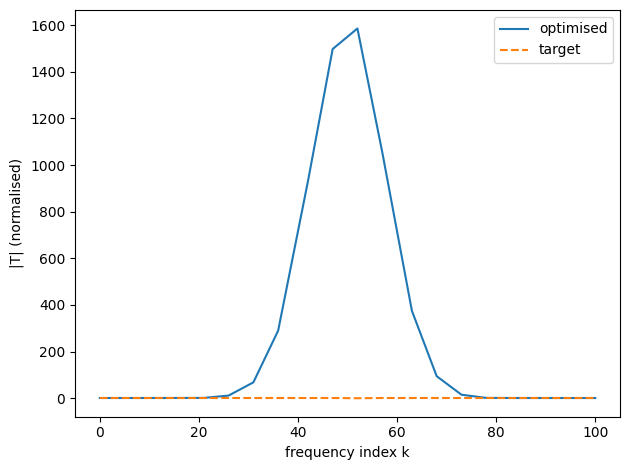

Initial field animation → /home/josalferr/Desktop/MMNLO_Sims/field_init.mp4
Optimised field animation → /home/josalferr/Desktop/MMNLO_Sims/field_final.mp4
